In [3]:
import warnings # We'll use this to suppress warnings caused by TensorFlow
warnings.simplefilter(action='ignore', category=FutureWarning)

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import tensorflow as tf 
tf.enable_eager_execution() # Must execute this at the beginning of the code
                            # See https://www.tensorflow.org/guide/eager for details
import time 

import imageio
import glob
import PIL


import os
data_dir = '/kaggle/input/celeba-dataset/'
os.listdir(data_dir)

#source: https://www.kaggle.com/code/cattnb/celeb-faces-gan-starter-code?rvi=1

['list_landmarks_align_celeba.csv',
 'img_align_celeba',
 'list_eval_partition.csv',
 'list_attr_celeba.csv',
 'list_bbox_celeba.csv']

In [4]:
list_eval_partition = pd.read_csv(data_dir + 'list_eval_partition.csv')
names_df = list_eval_partition['image_id']
names_df.head()

0    000001.jpg
1    000002.jpg
2    000003.jpg
3    000004.jpg
4    000005.jpg
Name: image_id, dtype: object

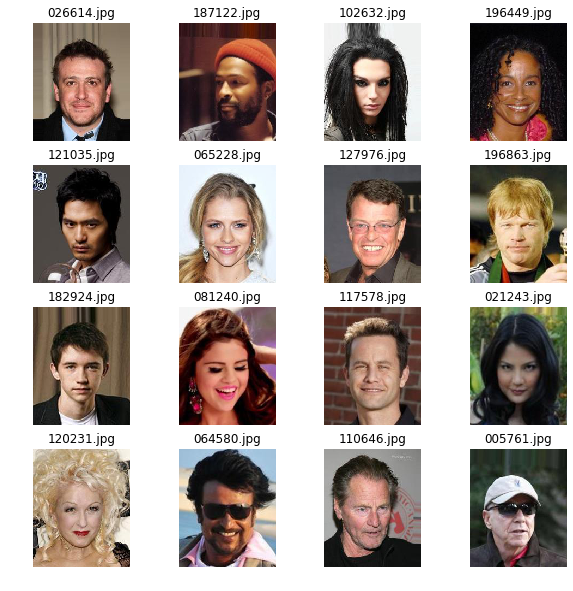

In [5]:
img_names = names_df.sample(n=16).values
shapes = []
plt.figure(figsize=(10,10))
for i, name in enumerate(img_names):
    plt.subplot(4, 4, i + 1)
    img = plt.imread(data_dir + 'img_align_celeba/img_align_celeba/' + name)
    shapes.append(img.shape)
    plt.imshow(img)
    plt.title(name)
    plt.axis('off')
_=plt.suptitle('')

#source: https://www.kaggle.com/code/cattnb/celeb-faces-gan-starter-code?rvi=1

In [6]:
#loading and presprocessign the images 
def load_and_preprocess_image(name):
    image = tf.io.read_file(data_dir + 'img_align_celeba/img_align_celeba/' + name)
    image = tf.image.decode_jpeg(image)
    image = tf.image.resize_images(image, (216, 176))
    image = (image - 127.5) / 127.5
    return image

In [7]:
BATCH_SIZE = 256
name_ds = tf.data.Dataset.from_tensor_slices(names_df.values)
image_ds = name_ds.map(load_and_preprocess_image, num_parallel_calls=tf.data.experimental.AUTOTUNE)
image_ds = image_ds.shuffle(buffer_size=2000).batch(BATCH_SIZE)

num_batches = int(np.ceil(len(names_df) / BATCH_SIZE))
print('There are {} batches'.format(num_batches))

There are 792 batches


In [8]:
#Building the Generator Model 
#A fully connected (dense) layer with 12 * 11 * 128 units, taking a 100-dimensional input (noise).
from tensorflow.keras import layers
def make_generator_model():
    model = tf.keras.Sequential()
    model.add(layers.Dense(12*11*128, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Reshape((12, 11, 128)))
    assert model.output_shape == (None, 12, 11, 128)

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(3, 4), padding='same', use_bias=False))
    assert model.output_shape == (None, 36, 44, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    model.add(layers.Conv2DTranspose(32, (5, 5), strides=(3, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 108, 88, 32)
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())

    model.add(layers.Conv2DTranspose(3, (5, 5), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 216, 176, 3)

    return model

#source: https://www.kaggle.com/code/cattnb/celeb-faces-gan-starter-code?rvi=1

The generator takes a 100-dimensional random noise vector as input and produces an image-like output with the specified dimensions. This architecture is a common choice for GAN generators and can be further adjusted based on the specific task and dataset.

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16896)             1689600   
_________________________________________________________________
batch_normalization (BatchNo (None, 16896)             67584     
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 16896)             0         
_________________________________________________________________
reshape (Reshape)            (None, 12, 11, 128)       0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 36, 44, 64)        204800    
_________________________________________________________________
batch_normalization_1 (Batch (None, 36, 44, 64)        256       
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 36, 44, 64)        0

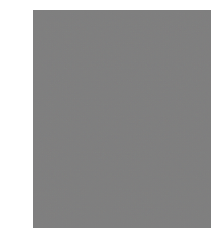

In [9]:
#Calling the Generator Model
generator = make_generator_model()
noise_image = tf.random.normal([1,100,])
generated_image = generator(noise_image, training=False)
plt.imshow((generated_image[0]*127.5 +127.5) / 255.)
_=plt.axis('off')
generator.summary()

In [10]:
#Building the Discriminator Model 
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=[216, 176, 3]))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(0.3))

    model.add(layers.Flatten())
    model.add(layers.Dense(1))

    return model

The discriminator is designed to take an input image and produce an output that indicates whether the input image is real or fake. It uses convolutional layers for feature extraction and a final dense layer for classification. The Leaky ReLU activations and dropout layers help introduce non-linearity and prevent overfitting.

In [11]:
#Calling the Discriminator Model 
discriminator = make_discriminator_model()
discriminator.summary()
print(discriminator(generated_image))

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 108, 88, 64)       4864      
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 108, 88, 64)       0         
_________________________________________________________________
dropout (Dropout)            (None, 108, 88, 64)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 54, 44, 128)       204928    
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 54, 44, 128)       0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 54, 44, 128)       0         
_________________________________________________________________
flatten (Flatten)            (None, 304128)           

In [12]:
#This code defines loss functions for training a GAN 
#consisting of a discriminator loss and a generator loss.
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
    real_loss = loss_obj(tf.ones_like(real_output), real_output)
    fake_loss = loss_obj(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

def generator_loss(fake_output):
    return loss_obj(tf.ones_like(fake_output), fake_output)

In [13]:
#Defining the optimizers 
gen_optimizer = tf.keras.optimizers.Adam(1e-4)
disc_optimizer = tf.keras.optimizers.Adam(1e-4)

In [14]:
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, 100])
    
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)
        
        disc_loss = discriminator_loss(real_output, fake_output)
        gen_loss = generator_loss(fake_output)
        
    disc_gradients = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    gen_gradients = gen_tape.gradient(gen_loss, generator.trainable_variables)
    
    disc_optimizer.apply_gradients(zip(disc_gradients, discriminator.trainable_variables))
    gen_optimizer.apply_gradients(zip(gen_gradients, generator.trainable_variables))
    
    return gen_loss, disc_loss

#source: https://www.kaggle.com/code/cattnb/celeb-faces-gan-starter-code?rvi=1

This function will help us visualize and save a group of generated images to visualize how our model is doing.

In [15]:
#Showing the generated images and undoing the preprocessing of the image done earlier
def show_and_generate_images(model, epoch, test_output):
    predictions = model(test_output, training=False)
    
    plt.figure(figsize=(10,10))
    for i in range(len(test_output)):
        plt.subplot(4,4,i+1)
        plt.imshow((predictions[i] * 127.5 +127.5) / 255.)
        plt.axis('off')
        
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    _=plt.show()

In [16]:
#Putting it all together, for each epoch, we will itterate over the dataset performing a 
#training step for each batch.  The history DataFrame is used for post training analysis 
#of the average loss of each model at each epoch.
def train(dataset, epochs):
    print('Begining to train...')
    
    history = pd.DataFrame(['gen_loss', 'disc_loss'])
    for epoch in range(epochs):
        start = time.time()
        epoch_gen_loss = tf.keras.metrics.Mean()
        epoch_disc_loss = tf.keras.metrics.Mean()
        for i, images in enumerate(dataset):
            gen_loss, disc_loss = train_step(images)
            epoch_gen_loss.update_state(gen_loss)
            epoch_disc_loss.update_state(disc_loss)

        show_and_generate_images(generator, epoch + 1, seed)
        stats = 'Epoch {0} took {1} seconds. Gen_loss: {2:0.3f}, Disc_loss: {3:0.3f}'
        print(stats.format(epoch + 1, int(time.time() - start), 
                           epoch_gen_loss.result().numpy(), 
                           epoch_disc_loss.result().numpy()))
        history = history.append({'gen_loss': epoch_gen_loss.result().numpy(), 
                                  'disc_loss': epoch_disc_loss.result().numpy()}, 
                                  ignore_index=True)
        
    return history

#source: https://www.kaggle.com/code/cattnb/celeb-faces-gan-starter-code?rvi=1

Begining to train...


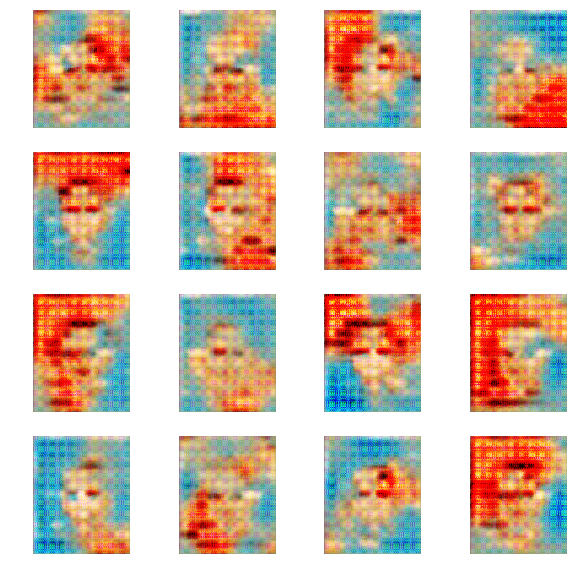

Epoch 1 took 1044 seconds. Gen_loss: 6.869, Disc_loss: 0.056


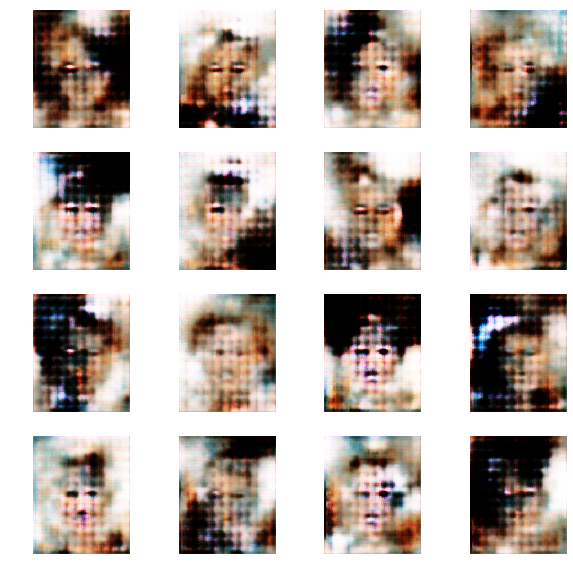

Epoch 2 took 670 seconds. Gen_loss: 4.123, Disc_loss: 0.214


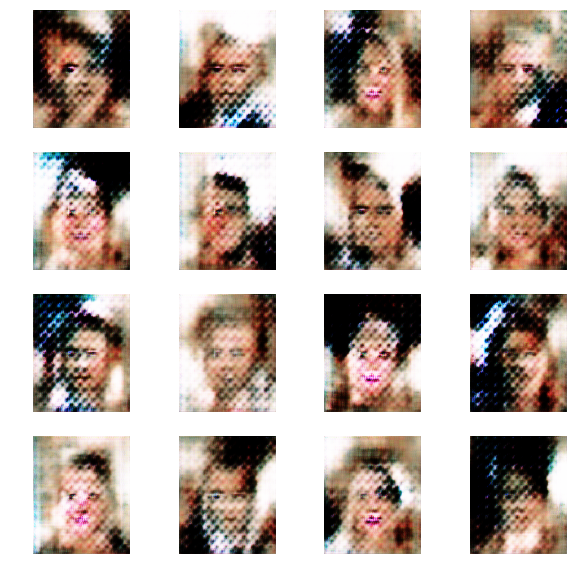

Epoch 3 took 675 seconds. Gen_loss: 3.110, Disc_loss: 0.333


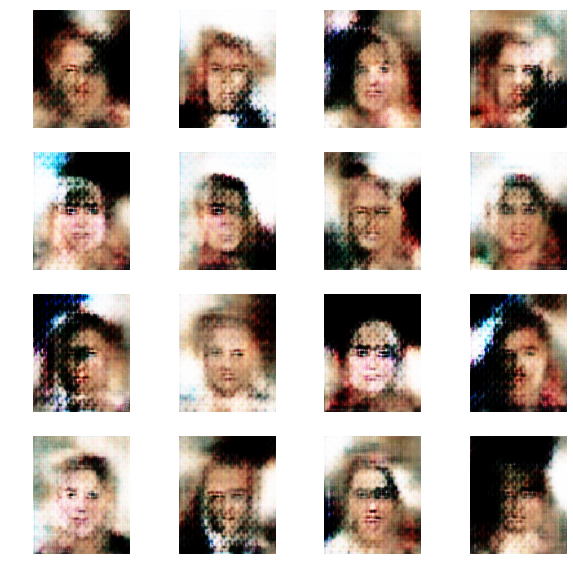

Epoch 4 took 691 seconds. Gen_loss: 2.964, Disc_loss: 0.399


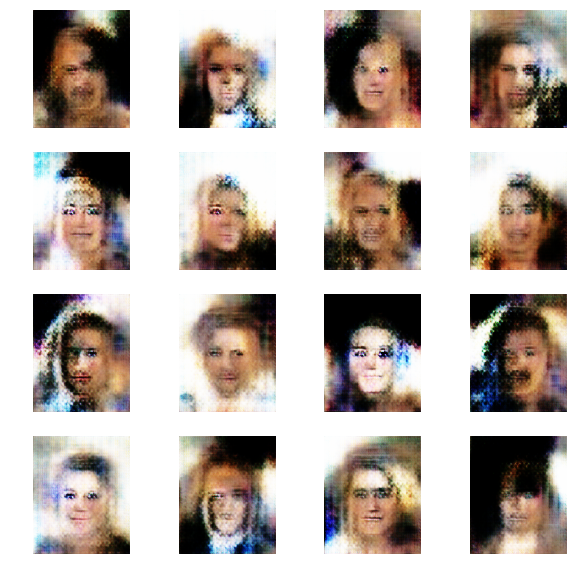

Epoch 5 took 669 seconds. Gen_loss: 2.713, Disc_loss: 0.506


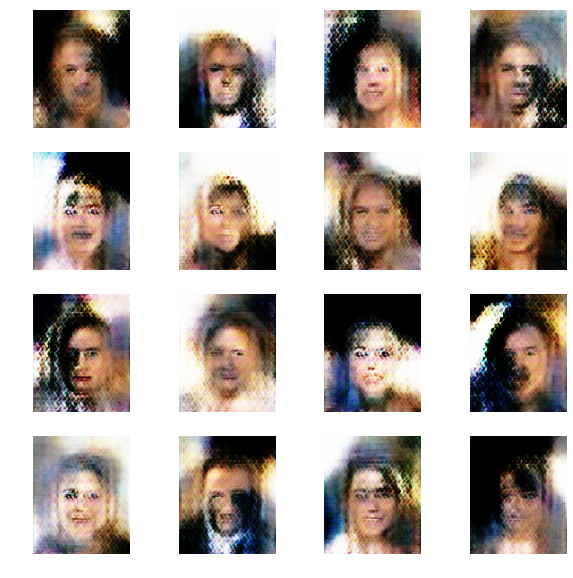

Epoch 6 took 660 seconds. Gen_loss: 2.559, Disc_loss: 0.526


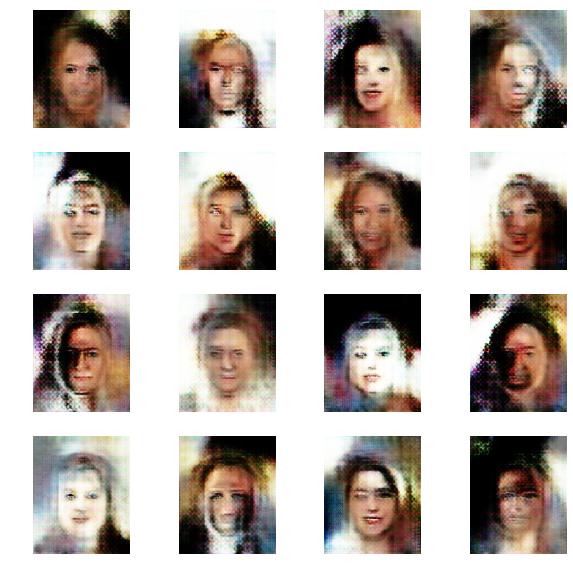

Epoch 7 took 650 seconds. Gen_loss: 2.637, Disc_loss: 0.493


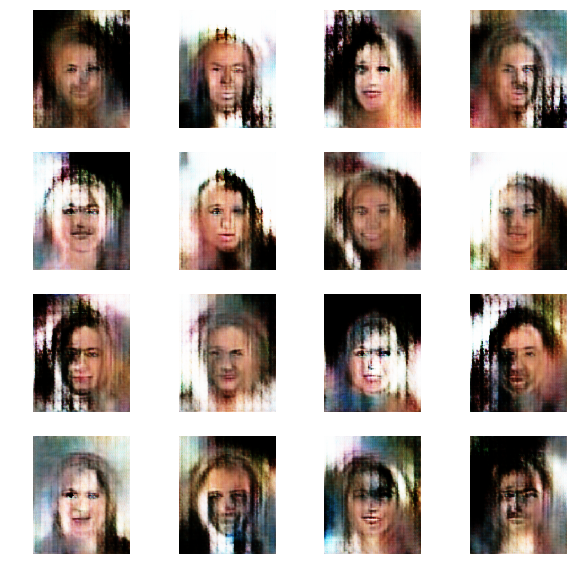

Epoch 8 took 651 seconds. Gen_loss: 2.724, Disc_loss: 0.490


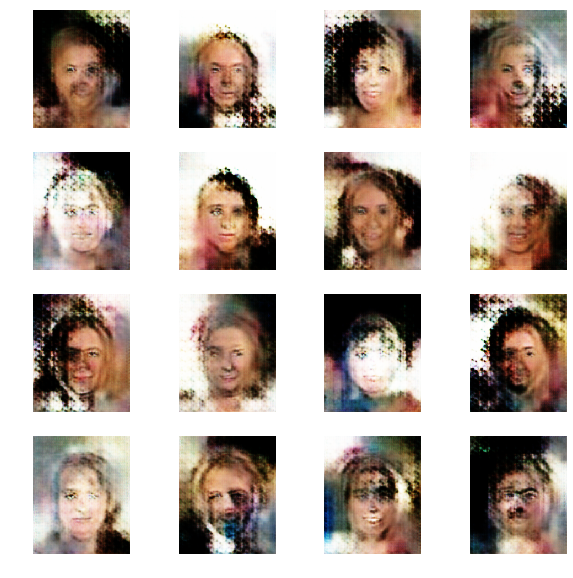

Epoch 9 took 726 seconds. Gen_loss: 2.863, Disc_loss: 0.458


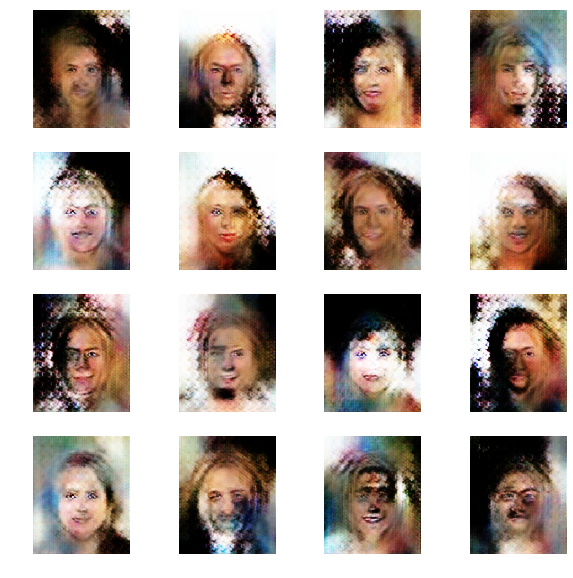

Epoch 10 took 684 seconds. Gen_loss: 2.823, Disc_loss: 0.428


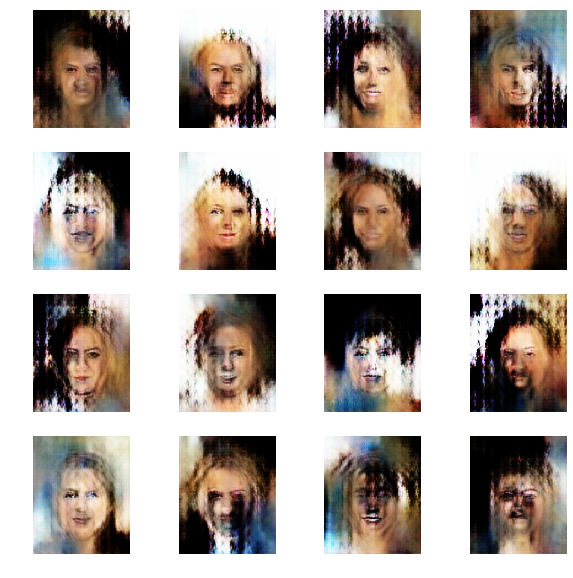

Epoch 11 took 684 seconds. Gen_loss: 2.956, Disc_loss: 0.438


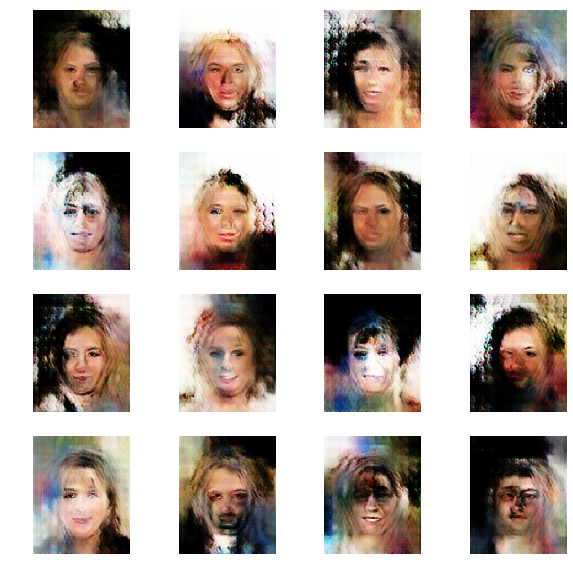

Epoch 12 took 679 seconds. Gen_loss: 3.082, Disc_loss: 0.408


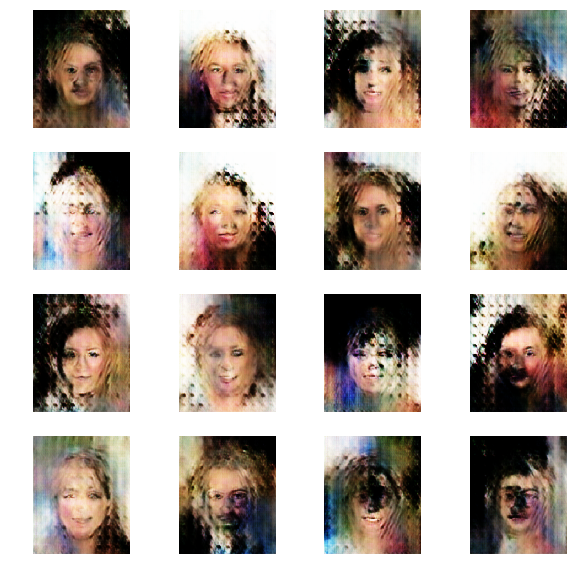

Epoch 13 took 678 seconds. Gen_loss: 3.104, Disc_loss: 0.414


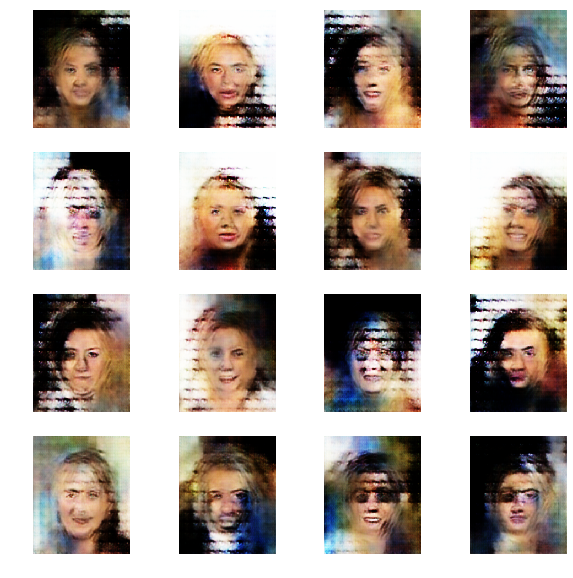

Epoch 14 took 686 seconds. Gen_loss: 3.367, Disc_loss: 0.364


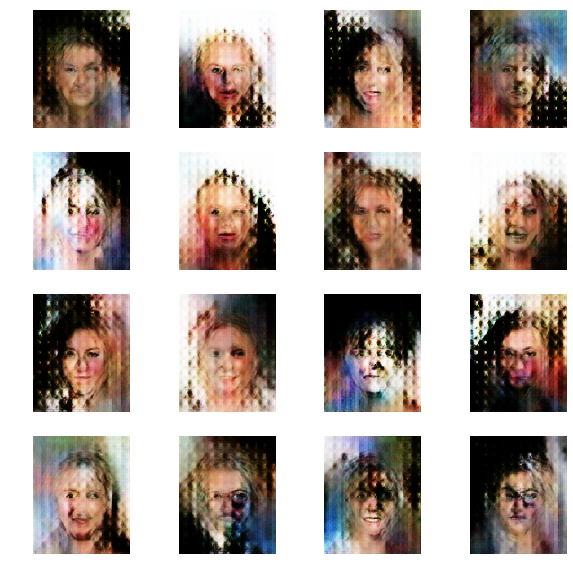

Epoch 15 took 685 seconds. Gen_loss: 3.478, Disc_loss: 0.378


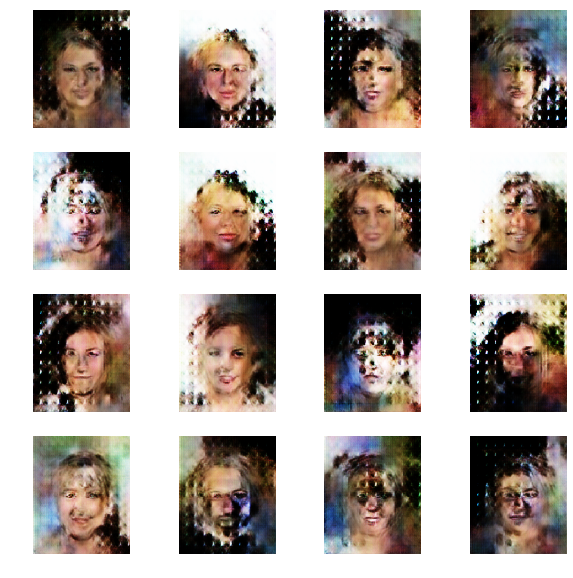

Epoch 16 took 674 seconds. Gen_loss: 3.358, Disc_loss: 0.375


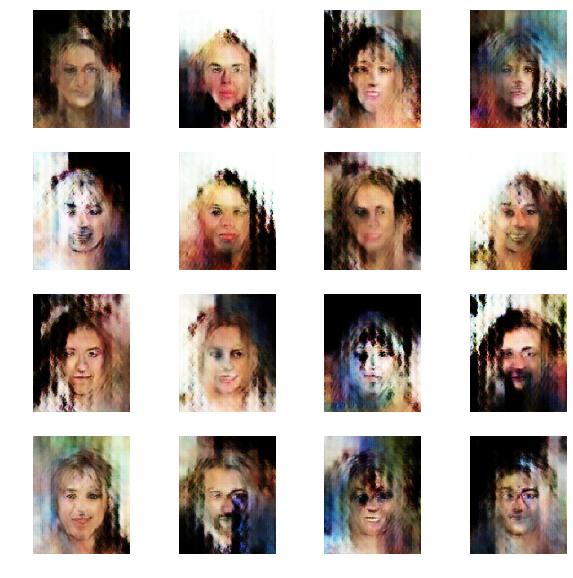

Epoch 17 took 654 seconds. Gen_loss: 3.425, Disc_loss: 0.357


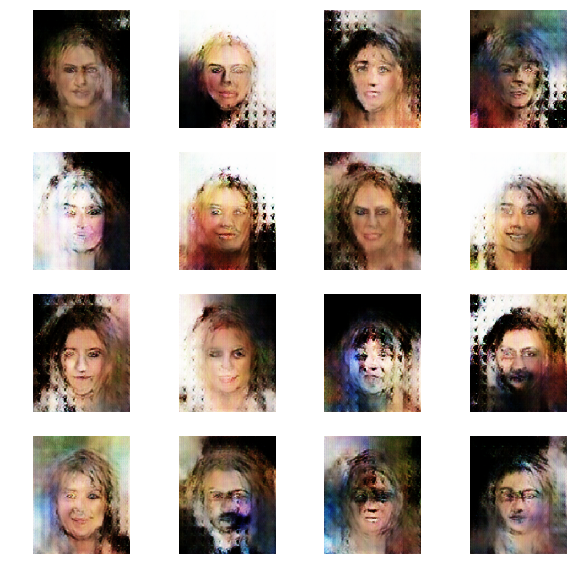

Epoch 18 took 668 seconds. Gen_loss: 3.568, Disc_loss: 0.307


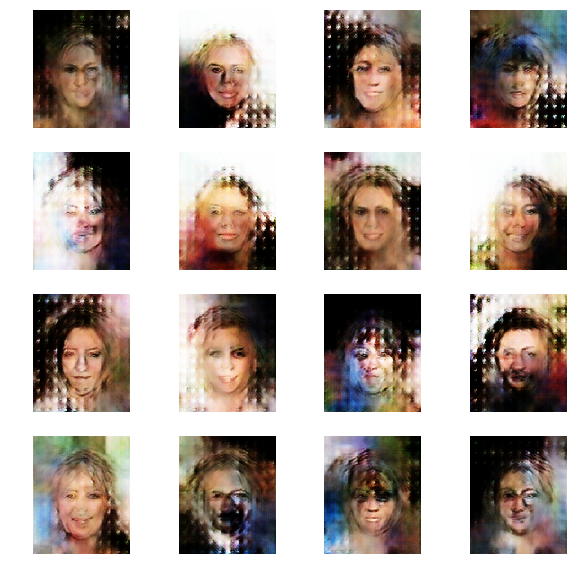

Epoch 19 took 664 seconds. Gen_loss: 3.707, Disc_loss: 0.298


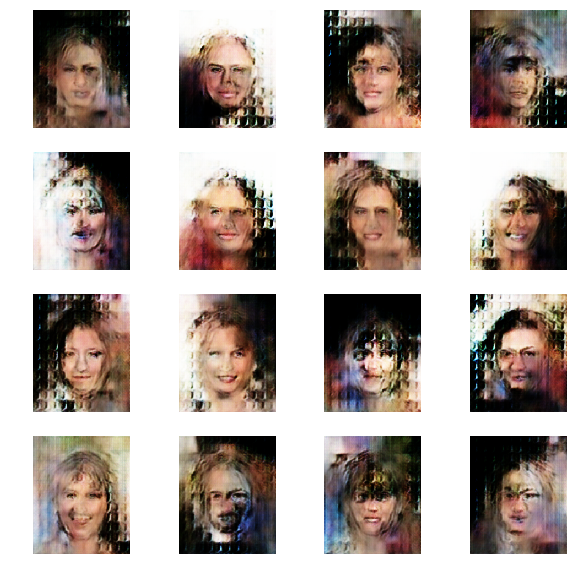

Epoch 20 took 664 seconds. Gen_loss: 3.753, Disc_loss: 0.358


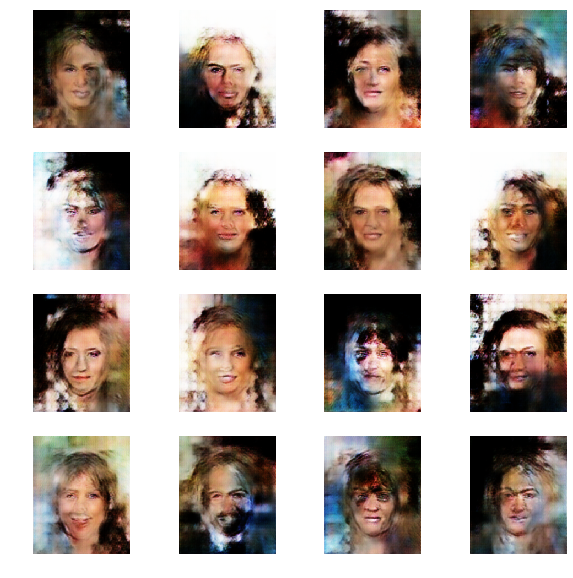

Epoch 21 took 664 seconds. Gen_loss: 3.649, Disc_loss: 0.328


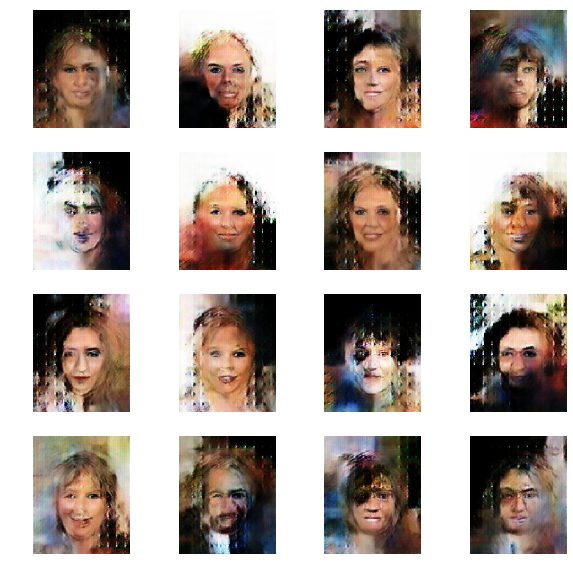

Epoch 22 took 668 seconds. Gen_loss: 3.589, Disc_loss: 0.290


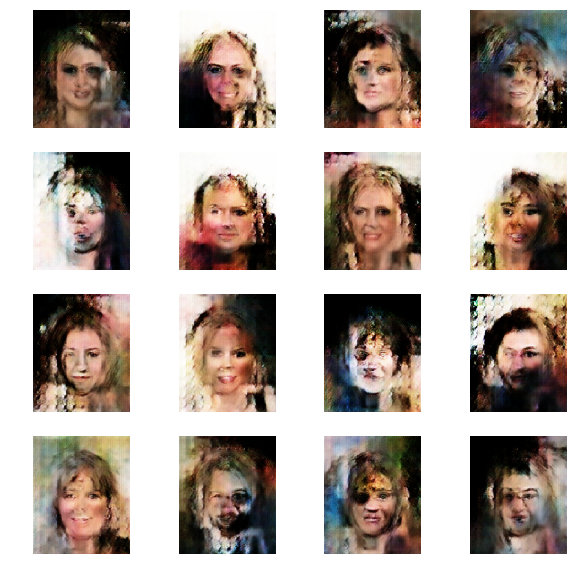

Epoch 23 took 668 seconds. Gen_loss: 3.897, Disc_loss: 0.314


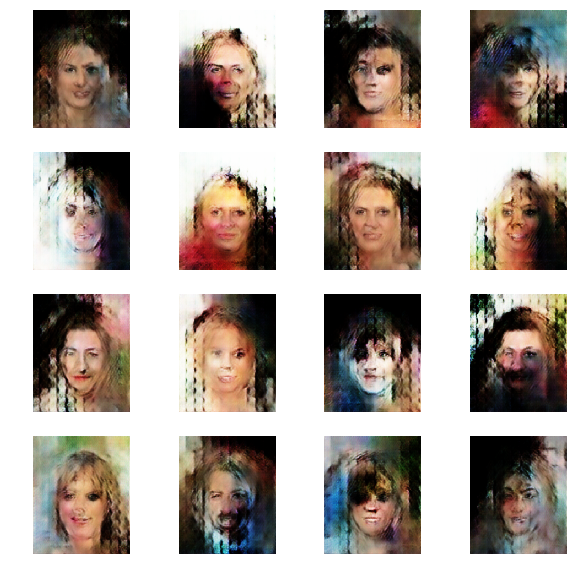

Epoch 24 took 679 seconds. Gen_loss: 4.072, Disc_loss: 0.288


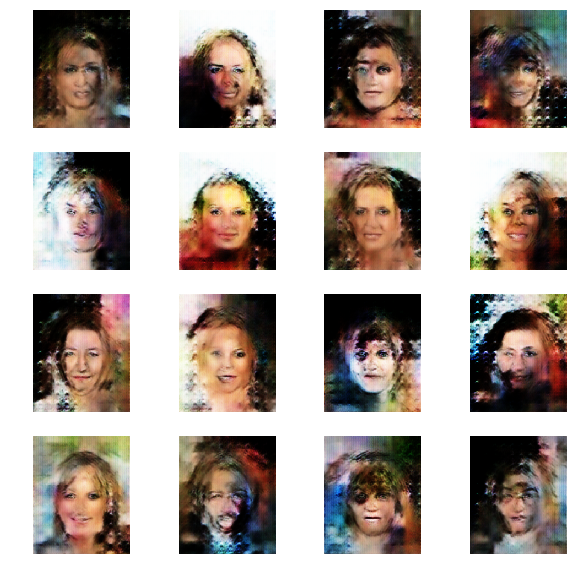

Epoch 25 took 675 seconds. Gen_loss: 4.129, Disc_loss: 0.267


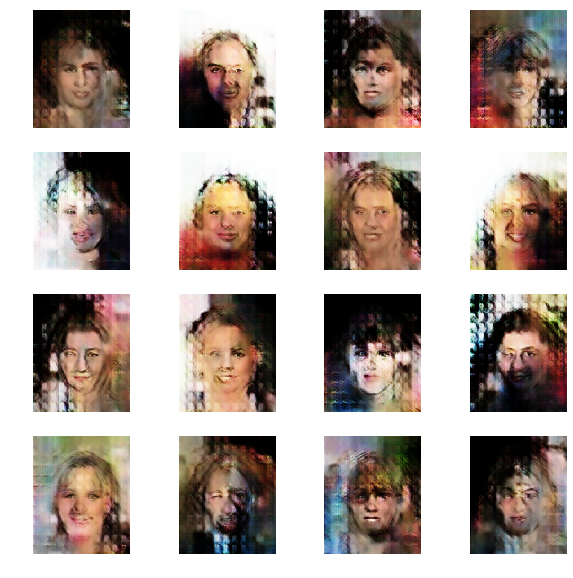

Epoch 26 took 672 seconds. Gen_loss: 4.020, Disc_loss: 0.280


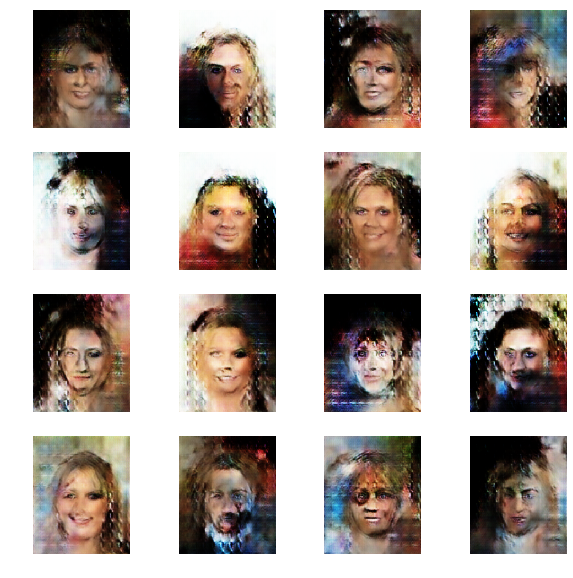

Epoch 27 took 674 seconds. Gen_loss: 3.987, Disc_loss: 0.311


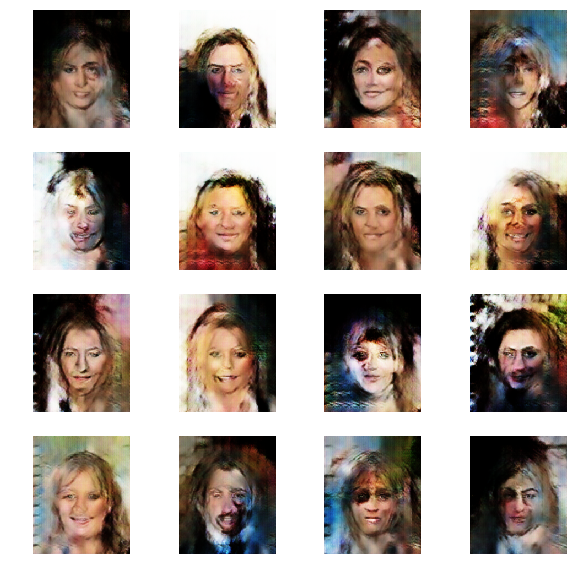

Epoch 28 took 671 seconds. Gen_loss: 3.836, Disc_loss: 0.290


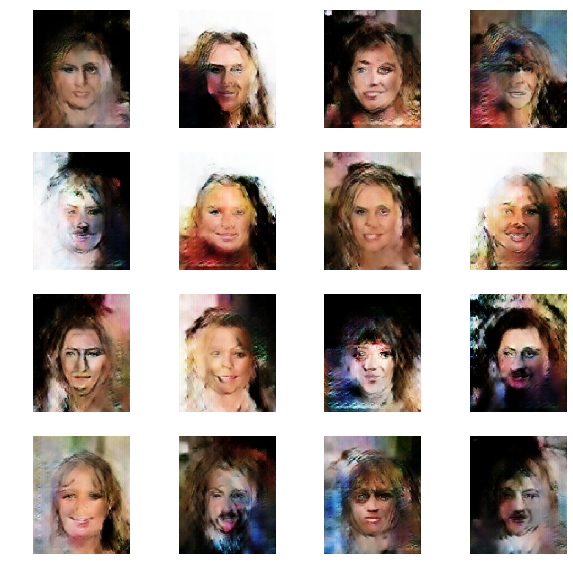

Epoch 29 took 669 seconds. Gen_loss: 4.027, Disc_loss: 0.270


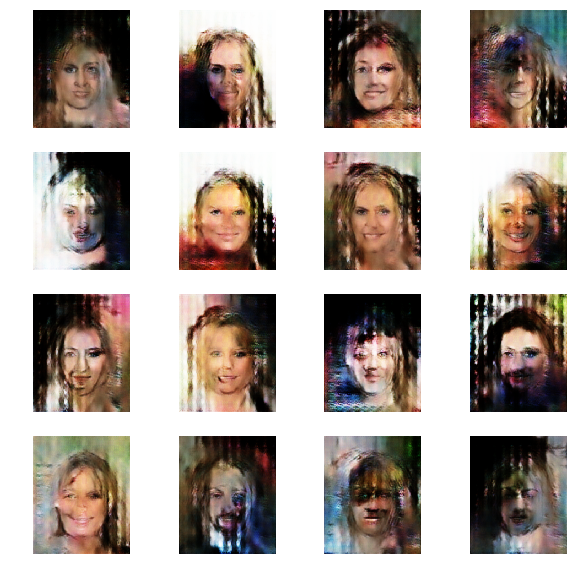

Epoch 30 took 693 seconds. Gen_loss: 3.951, Disc_loss: 0.274


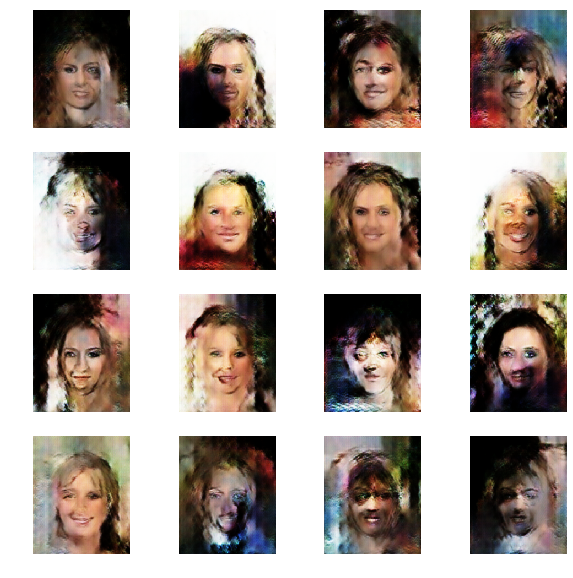

Epoch 31 took 668 seconds. Gen_loss: 3.955, Disc_loss: 0.326


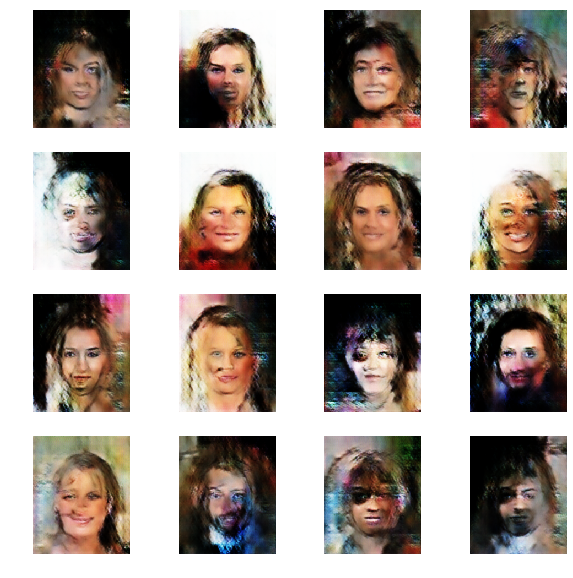

Epoch 32 took 668 seconds. Gen_loss: 3.887, Disc_loss: 0.297


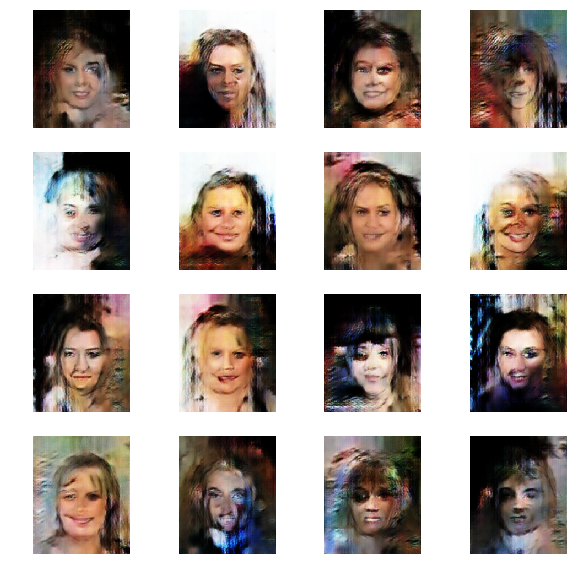

Epoch 33 took 668 seconds. Gen_loss: 3.863, Disc_loss: 0.304


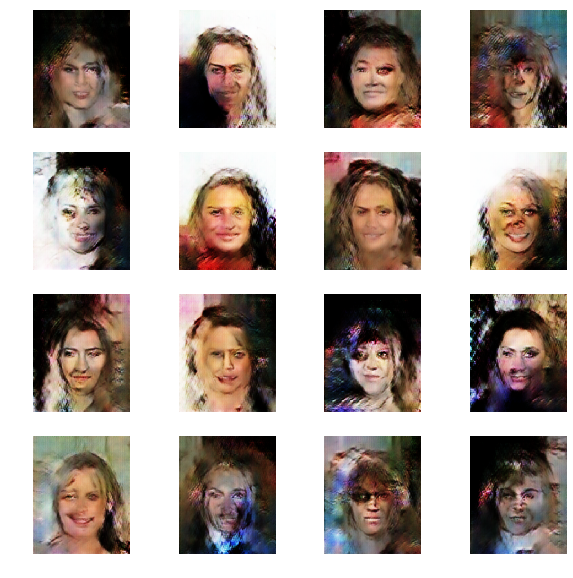

Epoch 34 took 666 seconds. Gen_loss: 3.900, Disc_loss: 0.326


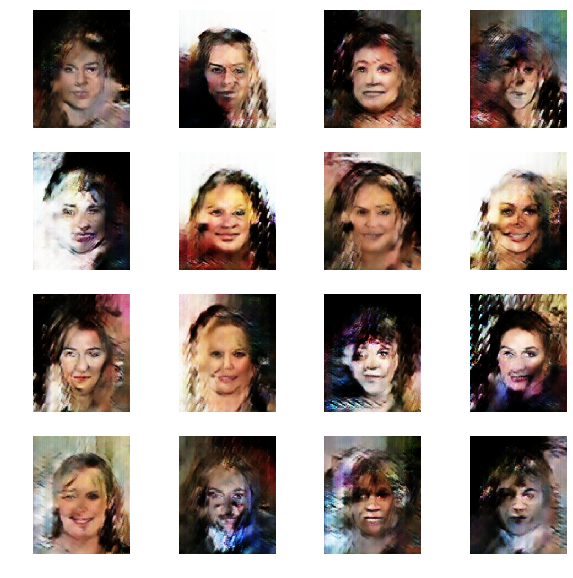

Epoch 35 took 670 seconds. Gen_loss: 3.947, Disc_loss: 0.305


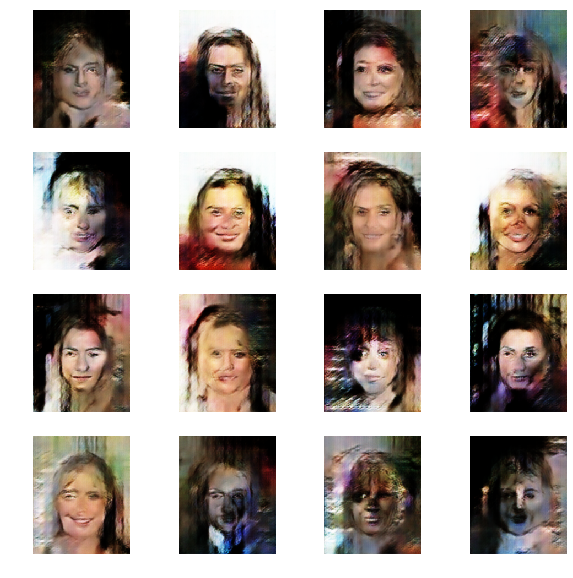

Epoch 36 took 682 seconds. Gen_loss: 3.990, Disc_loss: 0.355


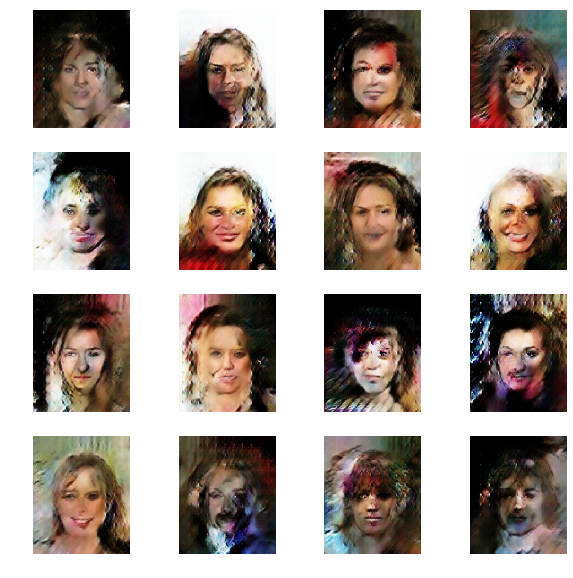

Epoch 37 took 666 seconds. Gen_loss: 3.814, Disc_loss: 0.365


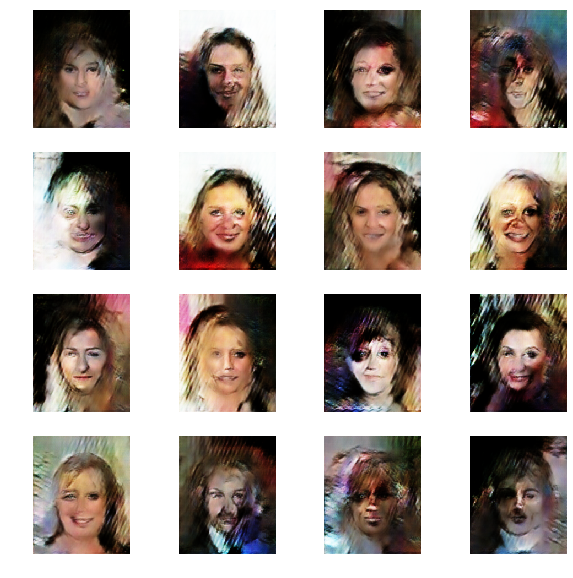

Epoch 38 took 669 seconds. Gen_loss: 3.838, Disc_loss: 0.369


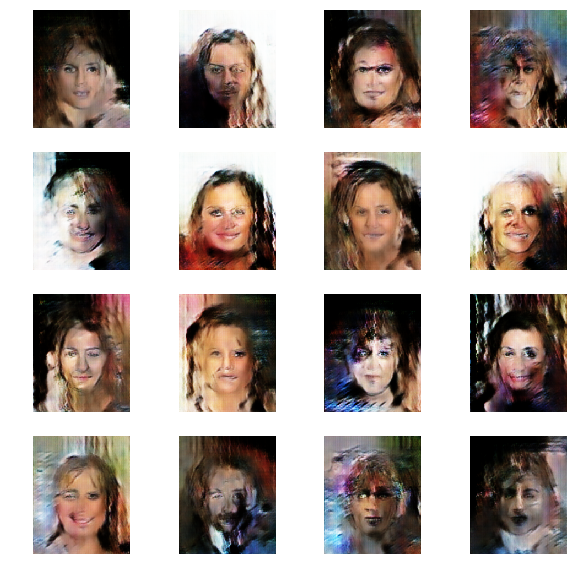

Epoch 39 took 680 seconds. Gen_loss: 3.873, Disc_loss: 0.368


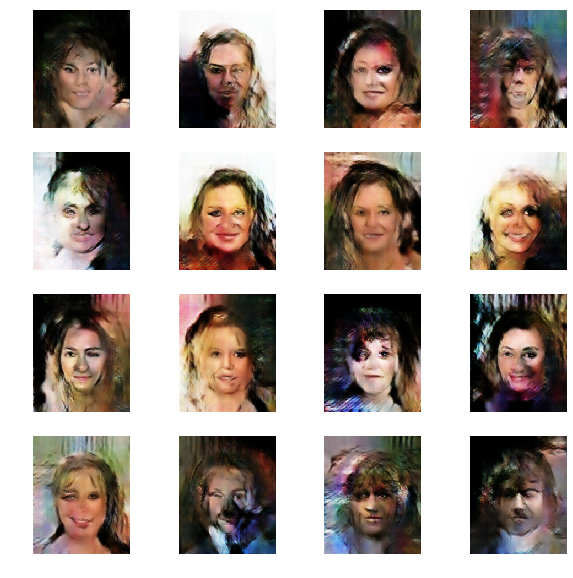

Epoch 40 took 673 seconds. Gen_loss: 3.786, Disc_loss: 0.354


In [17]:
EPOCHS = 40
seed = tf.random.normal([16, 100])
history = train(image_ds, EPOCHS)
history.index = history.index + 1

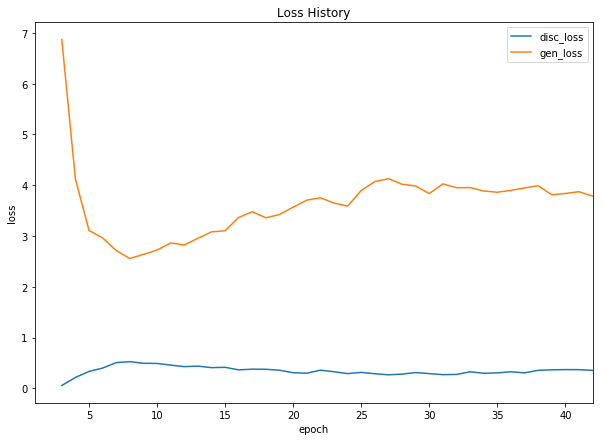

In [18]:
ax = plt.axes(xlabel='epoch', ylabel='loss')
history.plot(ax=ax, figsize=(10,7))
_=plt.title('Loss History')